<a href="https://colab.research.google.com/github/TravelingEngineer/Sandbox/blob/master/Audio_Processing_Rev0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Install Dependencies**

In [0]:
#!pip install PyDrive

**Import Libraries and Methods**

In [0]:
import os
#from pydrive.auth import GoogleAuth
#from pydrive.drive import GoogleDrive
from google.colab import auth
from google.colab import files
#from oauth2client.client import GoogleCredentials

import numpy as np
from IPython.display import Audio
from scipy.io import wavfile
from scipy import signal
import matplotlib.pyplot as plt
import math
#from python_speech_features import mfcc
#from python_speech_features import logfbank
#from python_speech_features import fbank
#%matplotlib inline
from numpy import mean, sqrt, square, arange
#import sounddevice as sd
#from tqdm import tnrange, tqdm_notebook
#from time import sleep
#import wave

**Manual Download**

In [0]:
#email Collins.AE6@gmail.com
#pswd machine_learning610
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!ls "/content/drive/My Drive/Training_Database"

data%2Fspeech_commands_v0.02.tar.gz  Training_Data_44_16_Mono_P1.wav
female_counting_16.wav		     Training_Data_44_16_Mono.wav


**Download from Google Drive**

In [0]:

gDrive= '/content/drive/My Drive/Training_Database/'

**Write Audio To Array**

In [0]:
file_speech = gDrive+'Training_Data_44_16_Mono_P1.wav'
fs, sig_speech = wavfile.read(file_speech)
sig_speech = sig_speech.astype(np.float) #converts wavefile from read only to write access
sig_speech /= 2**15 #converts 16 bit wavefile
sig_speech = sig_speech[np.newaxis] #shape array for convolution with gaussian impulse

In [86]:
Audio(sig_speech, rate=fs)

**Random Sample of Wave File**

In [0]:
#Grab a 5 sec chunk from the available data
#Segment_length=5*fs
#Random_Start=int(np.random.uniform(0,len(sig_speech)-Segment_length))
#print (Random_Start)
#sig_speech_sample=sig_speech[Random_Start:(Random_Start+Segment_length)]

199499


**Generate Exponential Decay Curve With White Noise**

In [70]:
framerate = 44100
length = 5
t = np.linspace(0,length,length*framerate)
t = t[np.newaxis]
#t.shape
#data = np.sin(2*np.pi*t)
#Rt=0.2
#Tau=Rt/4
#data=np.exp(-t/Tau)
#noise = np.random.normal(0, 1, len(t)) #random samples from a gaussian distribution
#noise /= np.max(noise) #normalizes gaussian noise 
#gaussian_impulse= data*noise

(1, 220500)

In [0]:
Rt=np.logspace(np.log10(0.2), np.log10(2), num=20) #creates 1-D array
Tau=Rt/4  
Tau = Tau[:,np.newaxis] #slices Tau 
data.shape
data=np.exp(-t/Tau)
#data.shape
#data.size
noise = np.random.normal(0, 1, t.size) #random samples from a gaussian distribution, use full size of t
noise /= np.max(noise) #normalizes gaussian noise 
gaussian_impulse= data*noise

In [88]:
gaussian_impulse.shape
Rt

array([0.2       , 0.22576758, 0.254855  , 0.28768998, 0.32475535,
       0.36659614, 0.41382762, 0.46714429, 0.52733018, 0.59527029,
       0.67196366, 0.75853804, 0.85626648, 0.96658605, 1.09111896,
       1.23169642, 1.39038559, 1.56951994, 1.77173358, 2.        ])

**Plot Wavefile**

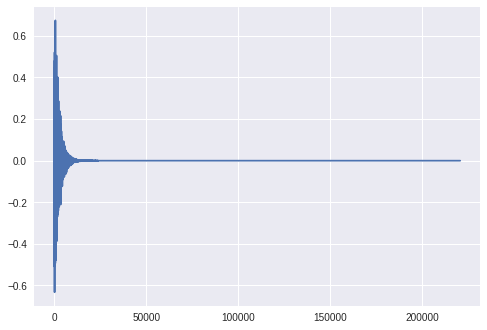

In [80]:
plt.plot(gaussian_impulse[1])
#plt.ylabel('some numbers')
plt.show()

**Convolution**

In [0]:
speech_convolved = signal.fftconvolve(sig_speech,gaussian_impulse)

In [85]:
Audio(speech_convolved[0], rate=fs)

**Ouput Files**

In [0]:
#speech_con = speech_convolved[0]
#rt = Rt[-2]

In [0]:
os.mkdir(gDrive+'gaussian_database')
for rt, speech_con in zip(Rt,speech_convolved): #pair Rt to speech_convolved
  speech_con_normalized = speech_con/np.max(np.abs(speech_con))  
  speech_con_normalized *= 2**15
  speech_con_normalized = speech_con_normalized.astype(np.int16)

  outfile = gDrive+f'gaussian_database/speech_con_norm_{rt:g}_s.wav' #format name to include RT value
  wavfile.write(outfile, fs, speech_con_normalized)
#files.download(outfile)

In [97]:
!ls "{outfile}"

ls: cannot access '/content/drive/My Drive/Training_Database/speech_con_norm_1.77173_s.wav': No such file or directory


In [0]:
#OAuth client 183385823795-lffoe853dqv4f86rme7mlkiiiv29kfn3.apps.googleusercontent.com
#client Secret EYdqeHwhuwZrMLh89eRAvaky

Audio(noisy_data,rate=fs,autoplay=False)

uploaded = drive.CreateFile({'title': 'test.wav'})
uploaded.SetContentString('Training_Data_44_16_Mono_P1.wav')
uploaded.Upload()
print('Uploaded file with ID {}'.format(uploaded.get('id')))

#upload = drive.CreateFile({'title': 'test.wav'})
#upload.SetContentFile('noise.wav')
#upload.Upload()